# Exploratory Data Analysis (EDA)

Exploratory data analysis (EDA) is used by data scientists to analyze and investigate data sets and summarize their main characteristics, employing data visualization.

This notebook includes:
- EDA: missingness, distributions, feature–feature correlations, feature–target correlations
- Per-Country EDA (DE/FR)
- Time Series analysis (global & per-country): rolling means, autocorrelation function (ACF), cross-correlation with target
- Simple feature engineering: simple imputation comparison, simple selection, mutual information(MI), principal component analysis (PCA)

## 1. Configuration and Preparing

In [1]:
# ==== Configuration ====
DATA_DIR = "../data/"
X_TRAIN_PATH = f"{DATA_DIR}X_train_NHkHMNU.csv"
Y_TRAIN_PATH = f"{DATA_DIR}y_train_ZAN5mwg.csv"

# Time series analysis config
ROLL_WINDOWS = [7, 14, 30]

RANDOM_STATE = 47

In [2]:
# ==== Imports ====
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import VarianceThreshold, mutual_info_regression
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.ensemble import HistGradientBoostingRegressor

warnings.filterwarnings('ignore')
plt.rcParams['figure.figsize'] = (8, 5)  # one chart per figure

In [3]:
# ==== 1) Load data & basic checks ====
X = pd.read_csv(X_TRAIN_PATH)
y = pd.read_csv(Y_TRAIN_PATH)

assert "ID" in X.columns and "ID" in y.columns, "ID column must exist in both X and y"
df = X.merge(y, on="ID", how="left")

print("Shapes -> X:", X.shape, " y:", y.shape, " merged:", df.shape)
print("Columns:", list(df.columns))

display(df.head())

Shapes -> X: (1494, 35)  y: (1494, 2)  merged: (1494, 36)
Columns: ['ID', 'DAY_ID', 'COUNTRY', 'DE_CONSUMPTION', 'FR_CONSUMPTION', 'DE_FR_EXCHANGE', 'FR_DE_EXCHANGE', 'DE_NET_EXPORT', 'FR_NET_EXPORT', 'DE_NET_IMPORT', 'FR_NET_IMPORT', 'DE_GAS', 'FR_GAS', 'DE_COAL', 'FR_COAL', 'DE_HYDRO', 'FR_HYDRO', 'DE_NUCLEAR', 'FR_NUCLEAR', 'DE_SOLAR', 'FR_SOLAR', 'DE_WINDPOW', 'FR_WINDPOW', 'DE_LIGNITE', 'DE_RESIDUAL_LOAD', 'FR_RESIDUAL_LOAD', 'DE_RAIN', 'FR_RAIN', 'DE_WIND', 'FR_WIND', 'DE_TEMP', 'FR_TEMP', 'GAS_RET', 'COAL_RET', 'CARBON_RET', 'TARGET']


,ID,DAY_ID,COUNTRY,DE_CONSUMPTION,FR_CONSUMPTION,DE_FR_EXCHANGE,FR_DE_EXCHANGE,DE_NET_EXPORT,FR_NET_EXPORT,DE_NET_IMPORT,...,DE_RAIN,FR_RAIN,DE_WIND,FR_WIND,DE_TEMP,FR_TEMP,GAS_RET,COAL_RET,CARBON_RET,TARGET
0,1054,206,FR,0.210099,-0.427458,-0.606523,0.606523,NaN,0.692860,NaN,...,-0.172680,-0.556356,-0.790823,-0.283160,-1.069070,-0.063404,0.339041,0.124552,-0.002445,0.028313
1,2049,501,FR,-0.022399,-1.003452,-0.022063,0.022063,-0.573520,-1.130838,0.573520,...,-1.240300,-0.770457,1.522331,0.828412,0.437419,1.831241,-0.659091,0.047114,-0.490365,-0.112516
2,1924,687,FR,1.395035,1.978665,1.021305,-1.021305,-0.622021,-1.682587,0.622021,...,-0.480700,-0.313338,0.431134,0.487608,0.684884,0.114836,0.535974,0.743338,0.204952,-0.180840
3,297,720,DE,-0.983324,-0.849198,-0.839586,0.839586,-0.270870,0.563230,0.270870,...,-1.114838,-0.507570,-0.499409,-0.236249,0.350938,-0.417514,0.911652,-0.296168,1.073948,-0.260356
4,1101,818,FR,0.143807,-0.617038,-0.924990,0.924990,NaN,0.990324,NaN,...,-0.541465,-0.424550,-1.088158,-1.011560,0.614338,0.729495,0.245109,1.526606,2.614378,-0.071733


In [4]:
print("\nCOUNTRY value counts:")
if "COUNTRY" in df.columns:
    print(df["COUNTRY"].value_counts(dropna=False))
else:
    print("No COUNTRY column found.")

NON_FEATURE = {"ID", "COUNTRY", "TARGET"}
num_cols = [c for c in df.columns if c not in NON_FEATURE and pd.api.types.is_numeric_dtype(df[c])]
print("Numeric feature count:", len(num_cols))


COUNTRY value counts:
COUNTRY
FR    851
DE    643
Name: count, dtype: int64
Numeric feature count: 33


## 2. Missing Data Profiling

In [5]:
missing_counts = df.isna().sum().sort_values(ascending=False)
missing_pct = (missing_counts / len(df)).sort_values(ascending=False)
missing_df = pd.DataFrame({"missing_count": missing_counts, "missing_pct": missing_pct})
display(missing_df)

,missing_count,missing_pct
DE_NET_IMPORT,124,0.082999
DE_NET_EXPORT,124,0.082999
FR_TEMP,94,0.062918
DE_TEMP,94,0.062918
DE_WIND,94,0.062918
FR_WIND,94,0.062918
FR_RAIN,94,0.062918
DE_RAIN,94,0.062918
FR_NET_EXPORT,70,0.046854
FR_NET_IMPORT,70,0.046854


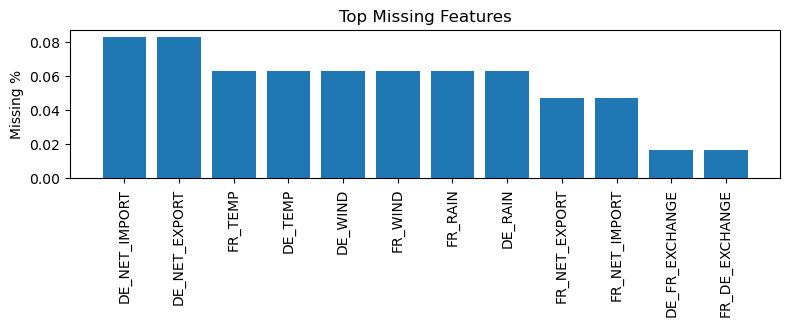

In [6]:
# Plot top missing features — single figure
top_miss = missing_df.head((missing_df['missing_count'] > 0).sum())
plt.figure()
plt.subplot(2, 1, 1)
plt.bar(top_miss.index.astype(str), top_miss["missing_pct"].values)
plt.xticks(rotation=90)
plt.ylabel("Missing %")
plt.title("Top Missing Features")
plt.tight_layout()
plt.show()

## 3. Check Outlier Data

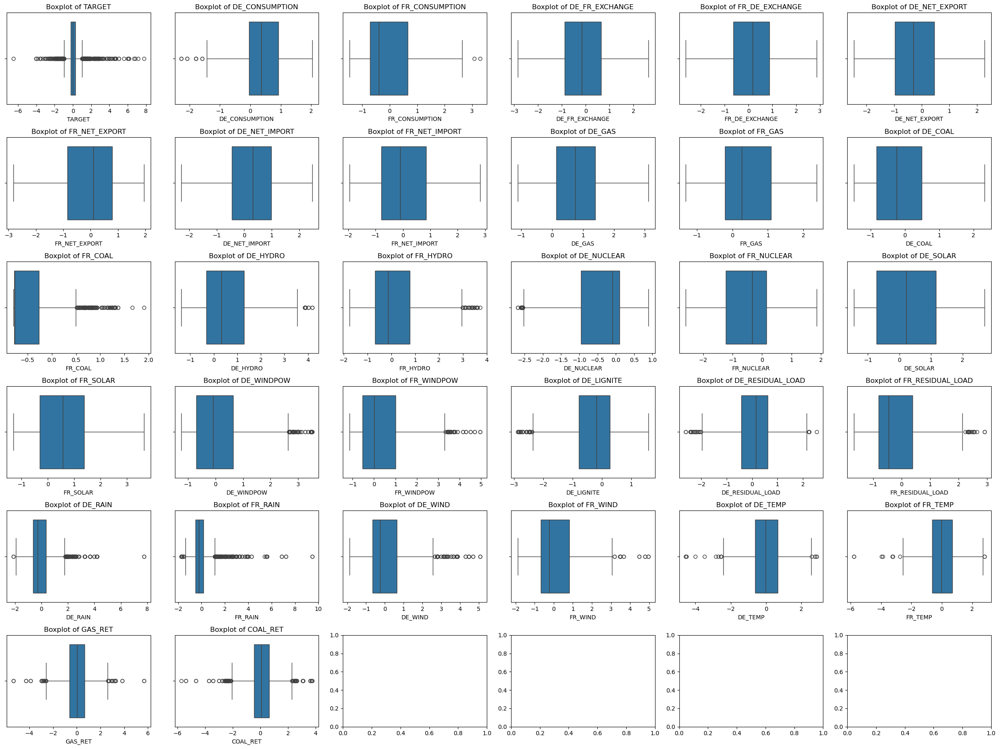

In [7]:
plots = [("TARGET", y["TARGET"])] + [(c, X[c]) for c in num_cols[1:-1]]

K = len(plots)
N = math.ceil(math.sqrt(K))              
M = math.ceil(K / N)                     

fig, axes = plt.subplots(M, N, figsize=(N*4, M*3), squeeze=False)
axes = axes.ravel()

for i, (name, s) in enumerate(plots):
    sns.boxplot(x=s, ax=axes[i])
    axes[i].set_title(f"Boxplot of {name}")

plt.tight_layout()
plt.show()

## 4. Distributions of Features

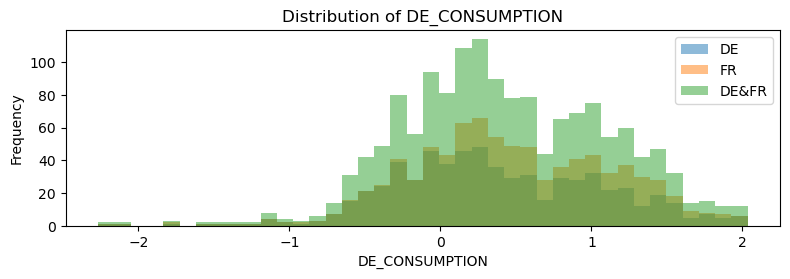

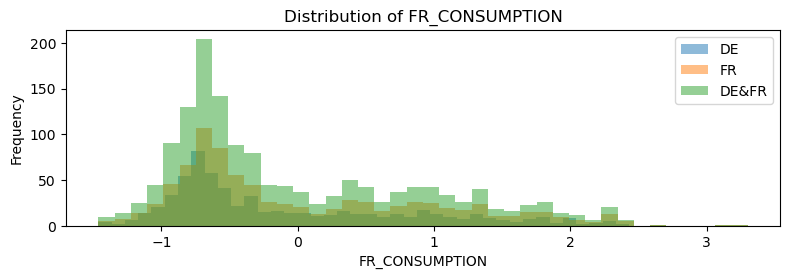

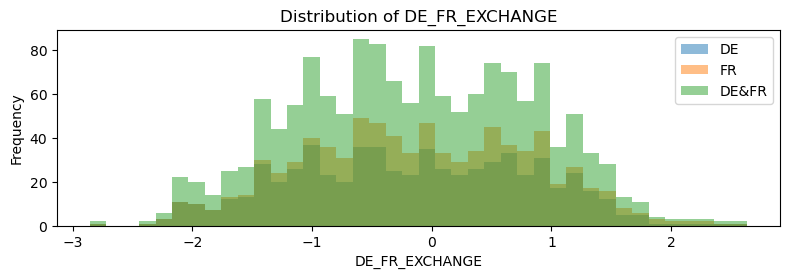

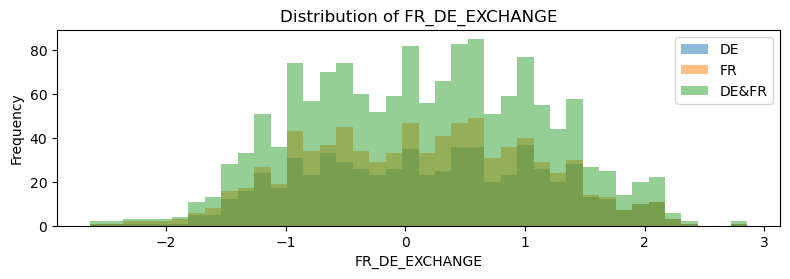

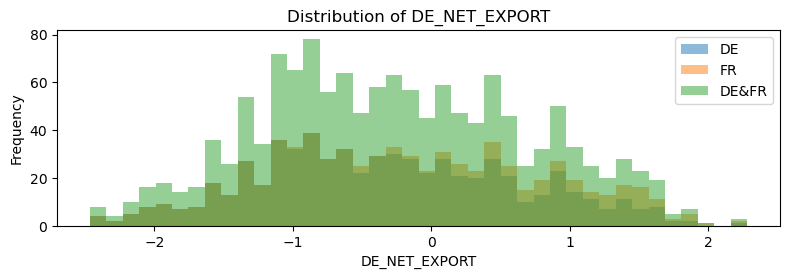

...

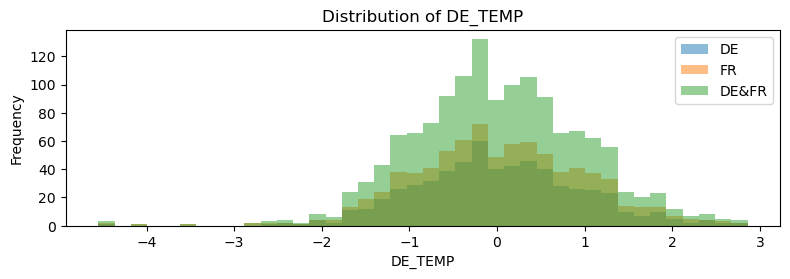

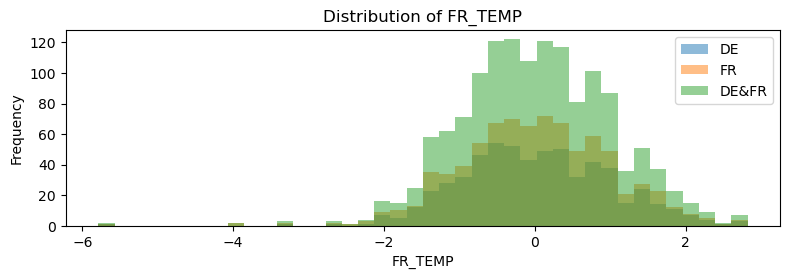

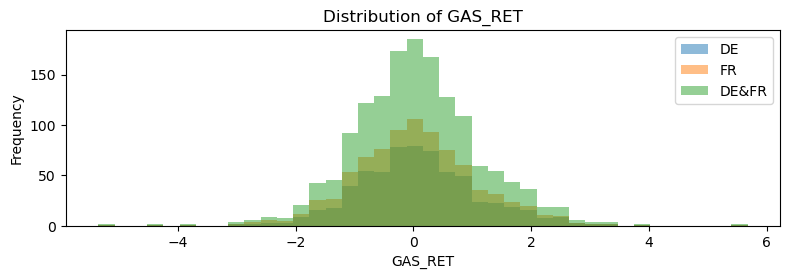

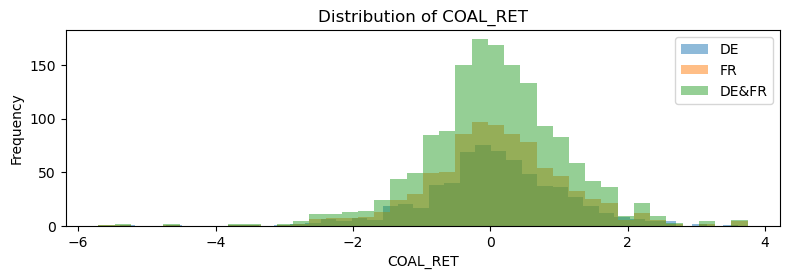

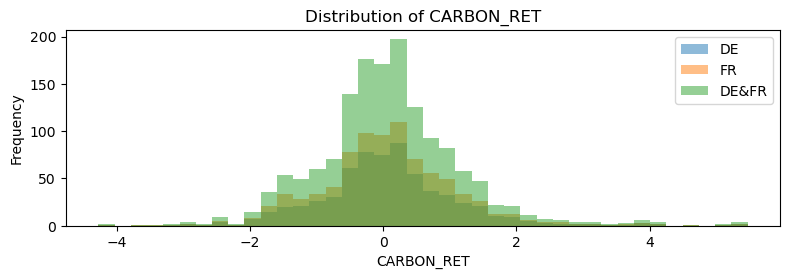

In [8]:
plot_cols = num_cols[1:]
for c in plot_cols:
    plt.figure()
    plt.subplot(2, 1, 1)
    if "COUNTRY" in df.columns:
        for k, g in df.groupby("COUNTRY"):
            g[c].plot(kind="hist", bins=40, alpha=0.5, label=str(k))
        df[c].plot(kind="hist", bins=40, alpha=0.5, label='DE&FR')    
        plt.legend()
    else:
        df[c].plot(kind="hist", bins=40, alpha=0.7, shade=True)
    plt.xlabel(c)
    plt.title(f"Distribution of {c}")
    plt.tight_layout()
    plt.show()

## 5. Feature-Feature Correlations

In [9]:
sns.PairGrid(X.merge(y, on='ID', how='left')).map(plt.scatter,s=5)

Correlation matrix shape: (33, 33)


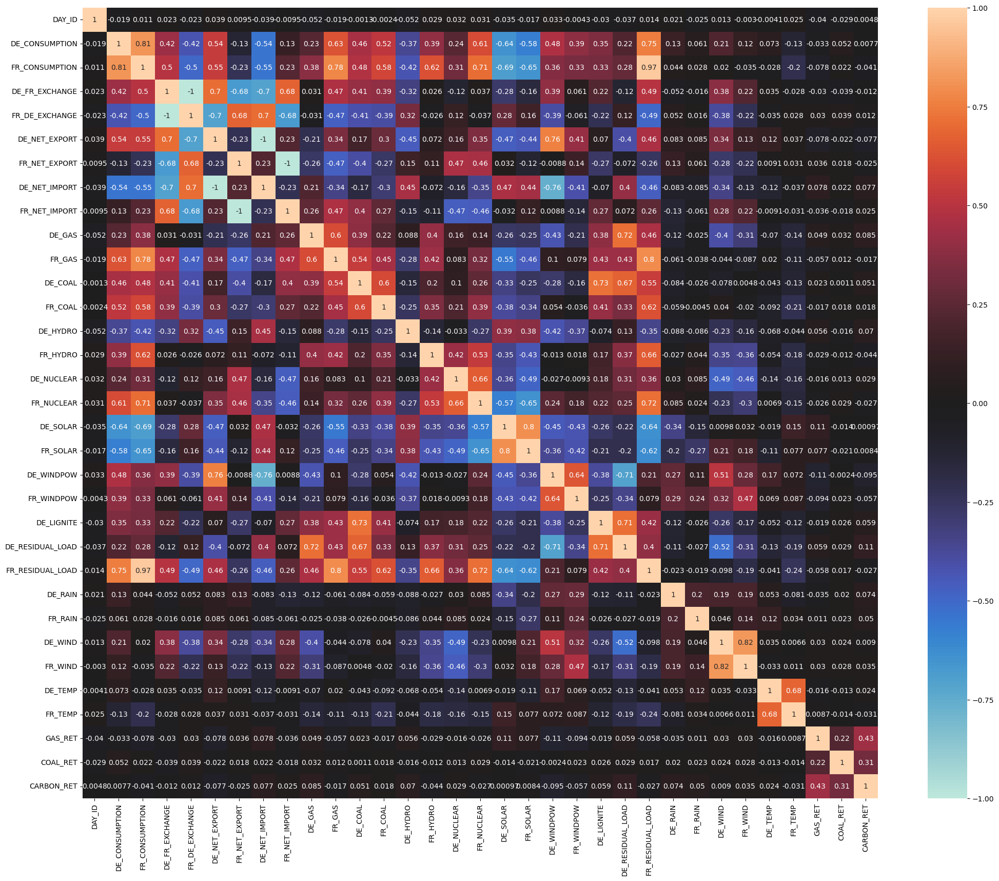

In [10]:
corr = df[num_cols].corr()
print("Correlation matrix shape:", corr.shape)

plt.figure(figsize=[25,20])
sns.heatmap(corr, annot=True, vmin=-1, vmax=1, center=0) 
plt.show()

In [11]:
# Top correlated pairs by |r|
pairs = []
cols = corr.columns
for i in range(len(cols)):
    for j in range(i+1, len(cols)):
        r = corr.iloc[i, j]
        pairs.append((cols[i], cols[j], abs(r), r))
pairs_sorted = sorted(pairs, key=lambda x: x[2], reverse=True)[:20]
pd.DataFrame(pairs_sorted, columns=["feat1", "feat2", "|r|", "r"])

,feat1,feat2,|r|,r
0,DE_FR_EXCHANGE,FR_DE_EXCHANGE,1.000000,-1.000000
1,DE_NET_EXPORT,DE_NET_IMPORT,1.000000,-1.000000
2,FR_NET_EXPORT,FR_NET_IMPORT,1.000000,-1.000000
3,FR_CONSUMPTION,FR_RESIDUAL_LOAD,0.965086,0.965086
4,DE_WIND,FR_WIND,0.820724,0.820724
5,DE_CONSUMPTION,FR_CONSUMPTION,0.813202,0.813202
6,DE_SOLAR,FR_SOLAR,0.803381,0.803381
7,FR_GAS,FR_RESIDUAL_LOAD,0.795914,0.795914
8,FR_CONSUMPTION,FR_GAS,0.779727,0.779727
9,DE_NET_EXPORT,DE_WINDPOW,0.763398,0.763398


## 6. Feature-Target Correlations

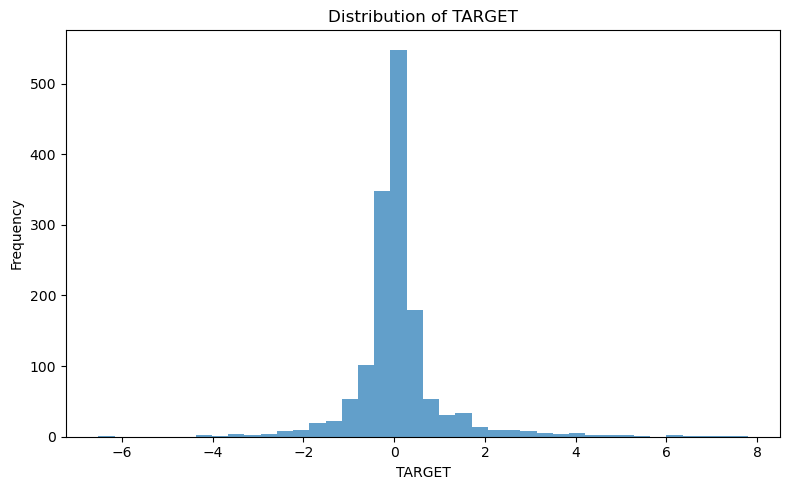

In [12]:
# Distribution of Target
plt.figure()
df["TARGET"].plot(kind="hist", bins=40, alpha=0.7)
plt.xlabel("TARGET")
plt.title(f"Distribution of TARGET")
plt.tight_layout()
plt.show()

In [13]:
assert "TARGET" in df.columns, "TARGET missing after merge"
target_corr = df[num_cols + ["TARGET"]].corr()["TARGET"].drop("TARGET").sort_values(ascending=False)
display(target_corr)

DE_NET_IMPORT       0.154301
DE_RESIDUAL_LOAD    0.132555
DE_GAS              0.096657
DE_HYDRO            0.086127
FR_HYDRO            0.052820
DE_COAL             0.045181
GAS_RET             0.041969
CARBON_RET          0.038252
DE_LIGNITE          0.034433
FR_RESIDUAL_LOAD    0.030254
FR_NET_IMPORT       0.025213
FR_GAS              0.024652
DE_SOLAR            0.021934
FR_SOLAR            0.021081
FR_DE_EXCHANGE      0.020330
FR_COAL             0.015732
DE_NUCLEAR          0.012236
FR_NUCLEAR          0.001588
FR_CONSUMPTION     -0.005685
COAL_RET           -0.010285
DAY_ID             -0.011612
DE_FR_EXCHANGE     -0.020330
FR_NET_EXPORT      -0.025213
DE_RAIN            -0.040206
FR_RAIN            -0.040926
DE_TEMP            -0.044189
FR_TEMP            -0.046516
FR_WIND            -0.050216
DE_CONSUMPTION     -0.052565
DE_WIND            -0.084127
FR_WINDPOW         -0.132523
DE_WINDPOW         -0.150287
DE_NET_EXPORT      -0.154301
Name: TARGET, dtype: float64

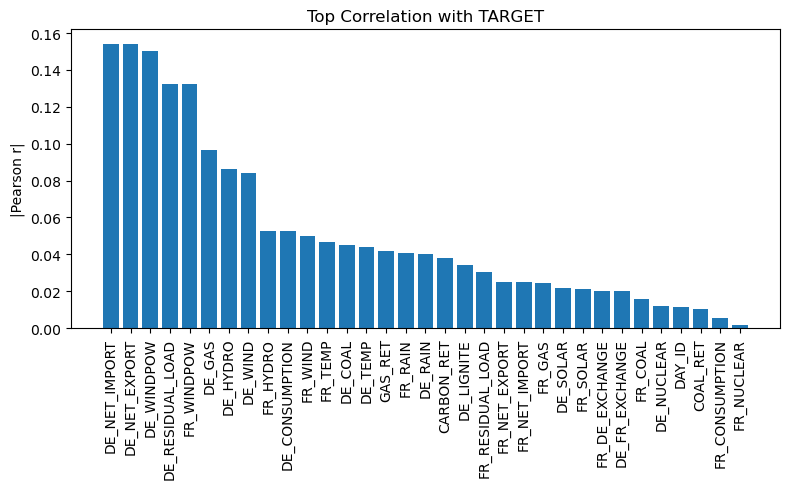

In [14]:
# Bar of absolute correlations (top-k)
tc_abs = target_corr.abs().sort_values(ascending=False)
plt.figure()
plt.bar(tc_abs.index.astype(str), tc_abs.values)
plt.xticks(rotation=90)
plt.ylabel("|Pearson r|")
plt.title("Top Correlation with TARGET")
plt.tight_layout()
plt.show()

## 7) Time Series Analysis

In [15]:
def ensure_time_sorted(d):
    if "DAY_ID" in d.columns:
        return d.sort_values("DAY_ID")
    return d.copy()

def acf_values(x, max_lag=30):
    x = pd.Series(x).astype(float).to_numpy()
    x = x - np.nanmean(x)
    n = len(x)
    acf = []
    denom = np.nansum(x*x)
    for lag in range(1, max_lag+1):
        if lag >= n:
            acf.append(np.nan)
            continue
        a = x[:-lag]
        b = x[lag:]
        num = np.nansum(a*b)
        acf.append(num / denom if denom != 0 else np.nan)
    return np.array(acf)

def lagged_corr(x, y, max_lag=30):
    x = pd.Series(x).astype(float).to_numpy()
    y = pd.Series(y).astype(float).to_numpy()
    lags = list(range(-max_lag, max_lag+1))
    vals = []
    for L in lags:
        if L < 0:
            xx = x[-L:]; yy = y[:len(y)+L]
        elif L > 0:
            xx = x[:-L]; yy = y[L:]
        else:
            xx = x; yy = y
        if len(xx) < 3:
            vals.append(np.nan); continue
        mask = np.isfinite(xx) & np.isfinite(yy)
        if mask.sum() < 3:
            vals.append(np.nan); continue
        xv = xx[mask]; yv = yy[mask]
        if np.std(xv)==0 or np.std(yv)==0:
            vals.append(np.nan); continue
        vals.append(np.corrcoef(xv, yv)[0,1])
    return np.array(lags), np.array(vals)

TS features (global): ['DE_NET_IMPORT', 'DE_NET_EXPORT', 'DE_WINDPOW', 'DE_RESIDUAL_LOAD', 'FR_WINDPOW', 'DE_GAS', 'DE_HYDRO', 'DE_WIND', 'FR_HYDRO', 'DE_CONSUMPTION', 'FR_WIND', 'FR_TEMP', 'DE_COAL', 'DE_TEMP', 'GAS_RET', 'FR_RAIN', 'DE_RAIN', 'CARBON_RET', 'DE_LIGNITE', 'FR_RESIDUAL_LOAD', 'FR_NET_EXPORT', 'FR_NET_IMPORT', 'FR_GAS', 'DE_SOLAR', 'FR_SOLAR', 'DE_FR_EXCHANGE', 'FR_DE_EXCHANGE', 'FR_COAL', 'DE_NUCLEAR', 'COAL_RET', 'FR_CONSUMPTION', 'FR_NUCLEAR']


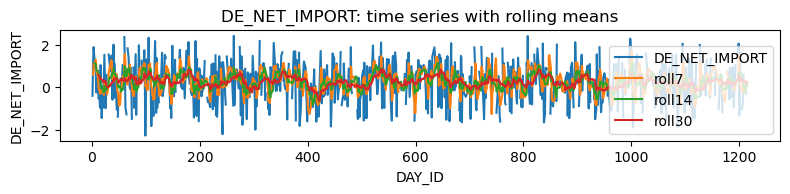

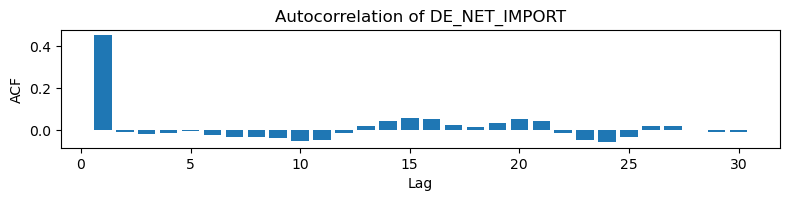

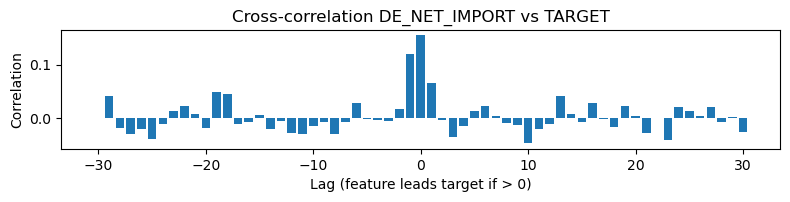

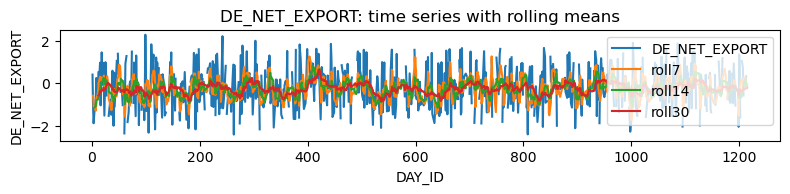

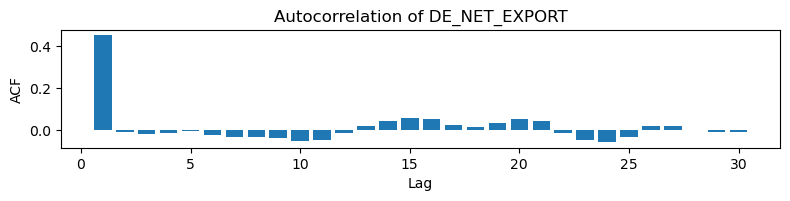

...

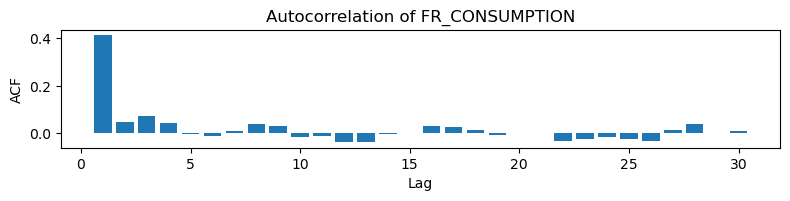

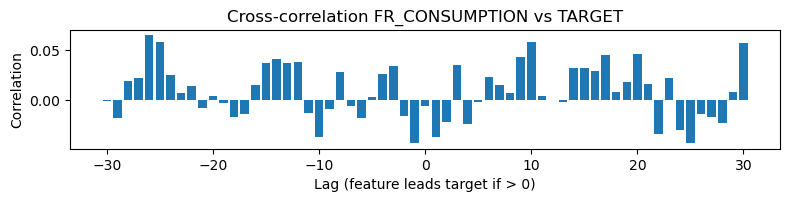

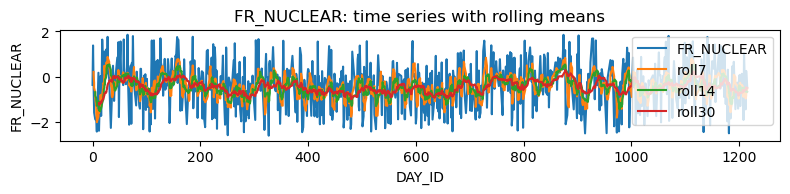

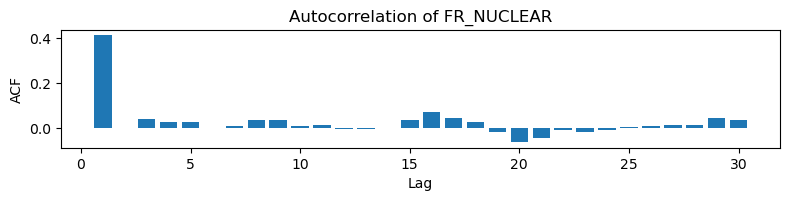

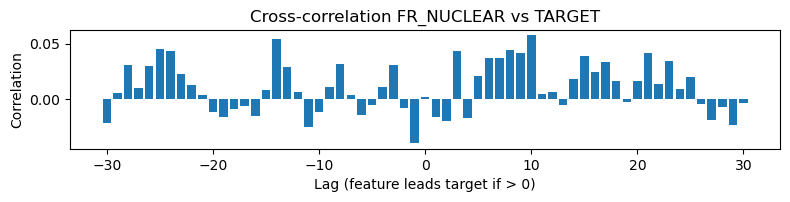

In [16]:
if "DAY_ID" not in df.columns:
    print("DAY_ID not found; skipping TS analysis.")
else:
    d = ensure_time_sorted(df)
    ts_candidates = d[num_cols[1:] + ["TARGET"]].corr()["TARGET"].drop("TARGET").abs().sort_values(ascending=False)
    ts_features = list(ts_candidates.index)
    print("TS features (global):", ts_features)
    yv = d["TARGET"].astype(float).to_numpy()
    
    for c in ts_features:
        # Original + rolling means
        s = d[c].astype(float)
        plt.figure()
        plt.subplot(311)
        plt.plot(d["DAY_ID"], s, label=f"{c}")
        for w in ROLL_WINDOWS:
            try:
                plt.plot(d["DAY_ID"], s.rolling(window=w, min_periods=max(1,w//2)).mean(), label=f"roll{w}")
            except Exception:
                pass
        plt.xlabel("DAY_ID"); plt.ylabel(c)
        plt.title(f"{c}: time series with rolling means")
        plt.legend()
        plt.tight_layout()
        plt.show()

        # ACF
        vals = d[c].astype(float).to_numpy()
        acf = acf_values(vals)
        plt.subplot(312)
        plt.bar(np.arange(1, len(acf)+1), acf)
        plt.xlabel("Lag"); plt.ylabel("ACF")
        plt.title(f"Autocorrelation of {c}")
        plt.tight_layout()
        plt.show()

        # Cross-correlation with TARGET
        xv = d[c].astype(float).to_numpy()
        lags, cc = lagged_corr(xv, yv)
        plt.subplot(313)
        plt.bar(lags, cc)
        plt.xlabel("Lag (feature leads target if > 0)")
        plt.ylabel("Correlation")
        plt.title(f"Cross-correlation {c} vs TARGET")
        plt.tight_layout()
        plt.show()

## 8. Per-Country EDA (FR / DE)

Countries found: ['FR', 'DE']

### COUNTRY: FR
Rows: 851; Numeric features: 33


,missing_count,missing_pct
DE_NET_IMPORT,124,0.145711
DE_NET_EXPORT,124,0.145711
FR_NET_IMPORT,70,0.082256
FR_NET_EXPORT,70,0.082256
FR_RAIN,47,0.055229
FR_TEMP,47,0.055229
DE_WIND,47,0.055229
FR_WIND,47,0.055229
DE_RAIN,47,0.055229
DE_TEMP,47,0.055229


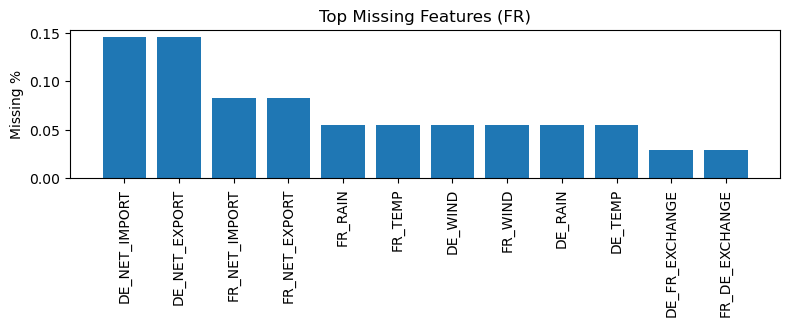

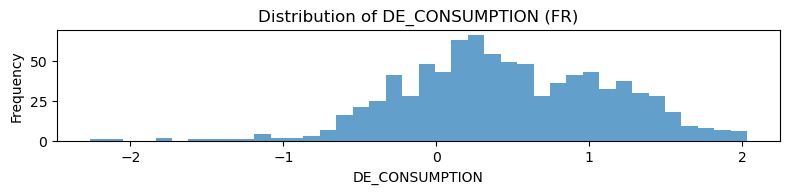

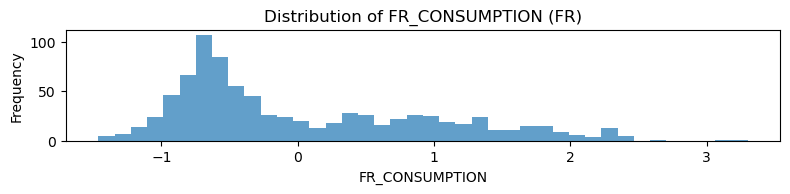

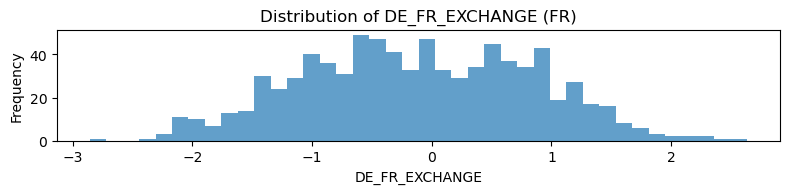

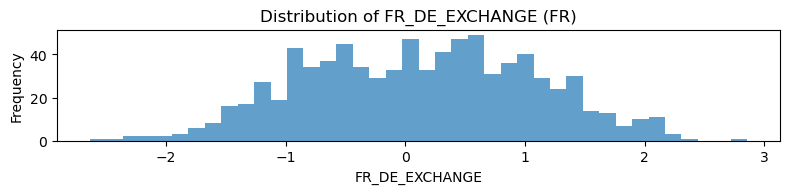

...

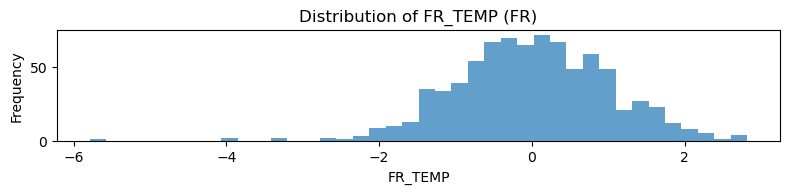

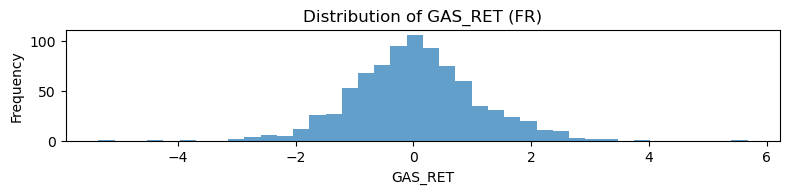

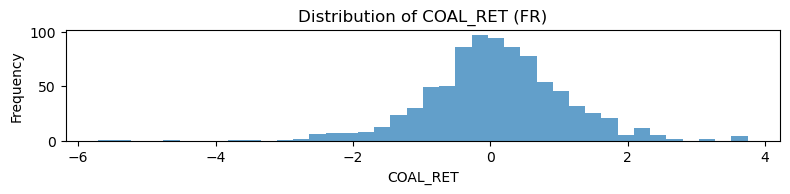

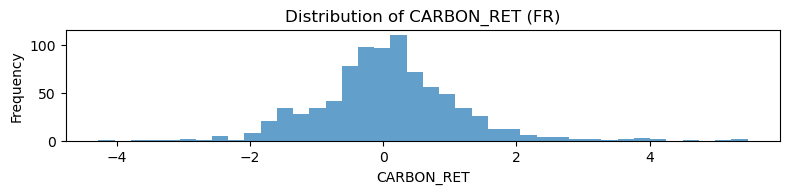

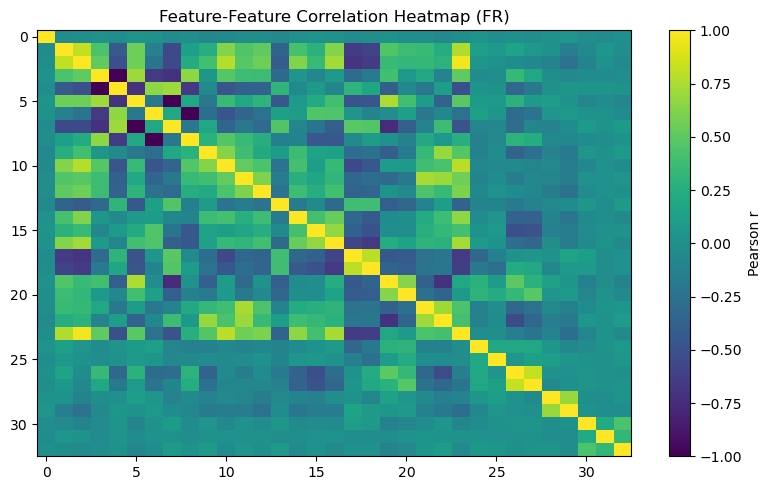

FR_HYDRO            0.070002
DE_NET_IMPORT       0.069824
CARBON_RET          0.064776
GAS_RET             0.057536
DE_HYDRO            0.052827
DE_RESIDUAL_LOAD    0.048185
FR_NET_IMPORT       0.043865
FR_RESIDUAL_LOAD    0.038176
DE_NUCLEAR          0.037859
DE_FR_EXCHANGE      0.034964
DE_GAS              0.031626
FR_COAL             0.031529
DE_SOLAR            0.029904
DE_COAL             0.021014
FR_SOLAR            0.013828
FR_CONSUMPTION      0.009998
FR_GAS              0.007433
FR_NUCLEAR          0.007304
DE_LIGNITE          0.005673
COAL_RET           -0.002330
DAY_ID             -0.025336
FR_WIND            -0.033683
FR_TEMP            -0.033776
FR_DE_EXCHANGE     -0.034964
FR_RAIN            -0.040963
FR_NET_EXPORT      -0.043865
DE_TEMP            -0.044049
DE_WIND            -0.046644
DE_CONSUMPTION     -0.048551
DE_RAIN            -0.067974
DE_NET_EXPORT      -0.069824
DE_WINDPOW         -0.073254
FR_WINDPOW         -0.107403
Name: TARGET, dtype: float64

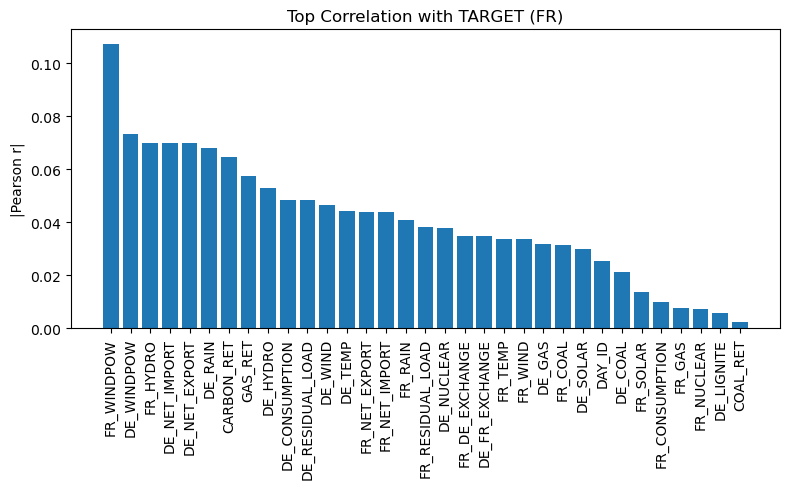


### COUNTRY: DE
Rows: 643; Numeric features: 33


,missing_count,missing_pct
FR_TEMP,47,0.073095
FR_WIND,47,0.073095
DE_WIND,47,0.073095
FR_RAIN,47,0.073095
DE_TEMP,47,0.073095
DE_RAIN,47,0.073095
DAY_ID,0,0.000000
DE_CONSUMPTION,0,0.000000
FR_CONSUMPTION,0,0.000000
DE_GAS,0,0.000000


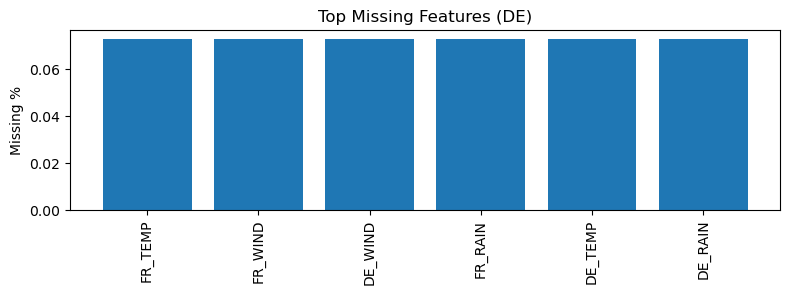

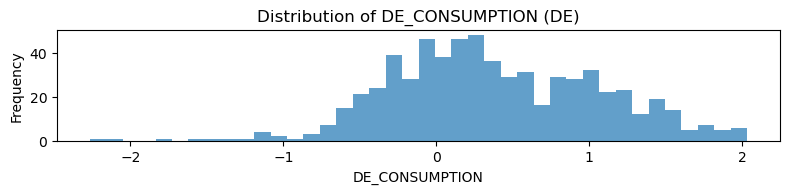

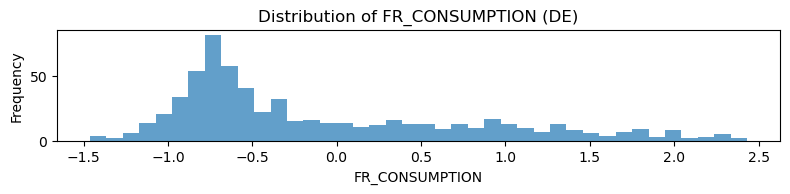

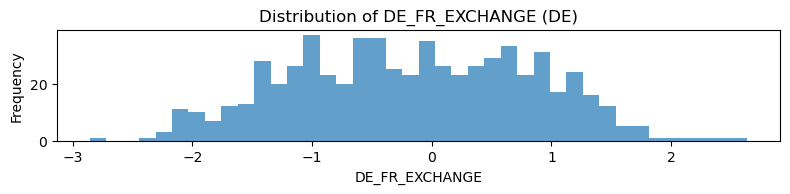

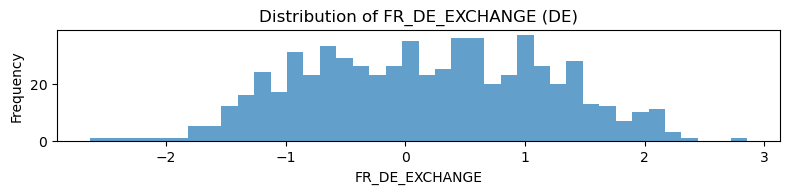

...

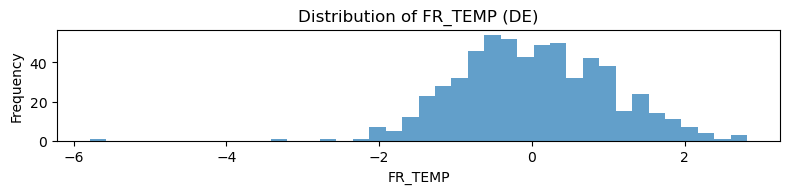

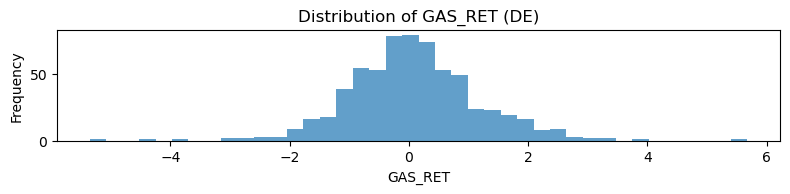

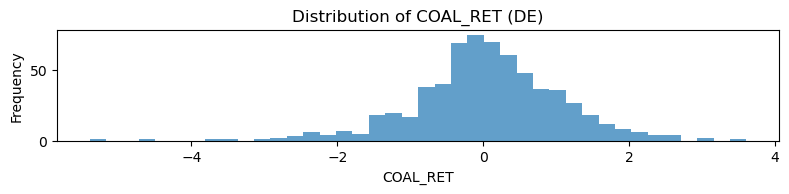

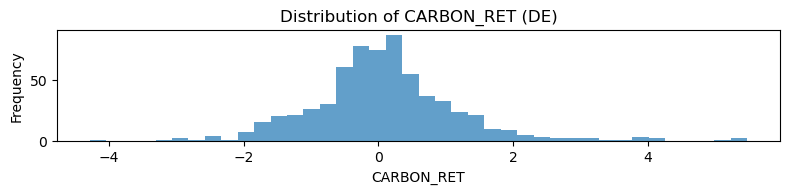

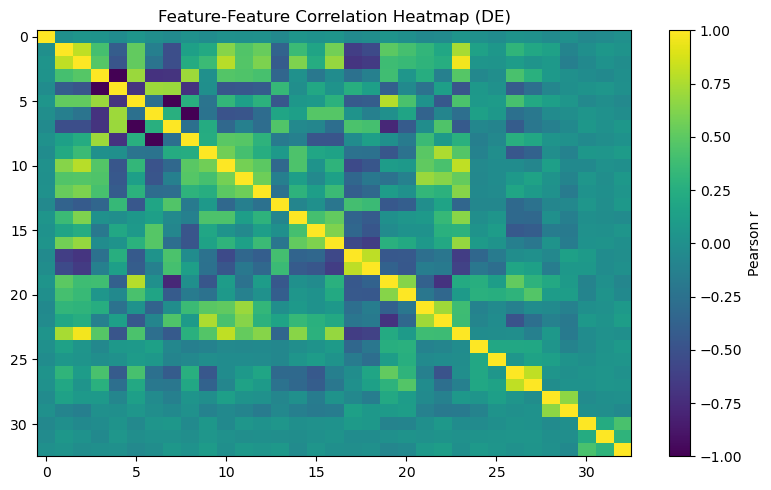

DE_RESIDUAL_LOAD    0.250898
DE_NET_IMPORT       0.250616
DE_GAS              0.177561
DE_HYDRO            0.123676
DE_COAL             0.097803
DE_LIGNITE          0.095619
FR_DE_EXCHANGE      0.084194
FR_GAS              0.048483
FR_HYDRO            0.038172
FR_RESIDUAL_LOAD    0.029686
FR_SOLAR            0.022717
GAS_RET             0.020087
FR_NUCLEAR          0.009855
DAY_ID              0.008573
DE_SOLAR            0.007162
FR_COAL             0.004934
CARBON_RET          0.003538
FR_NET_EXPORT       0.001544
FR_NET_IMPORT      -0.001544
DE_RAIN            -0.005381
DE_NUCLEAR         -0.006729
FR_CONSUMPTION     -0.019582
COAL_RET           -0.019866
FR_RAIN            -0.040447
DE_TEMP            -0.044221
DE_CONSUMPTION     -0.051182
FR_TEMP            -0.064272
FR_WIND            -0.083825
DE_FR_EXCHANGE     -0.084194
DE_WIND            -0.143149
FR_WINDPOW         -0.168554
DE_WINDPOW         -0.250204
DE_NET_EXPORT      -0.250616
Name: TARGET, dtype: float64

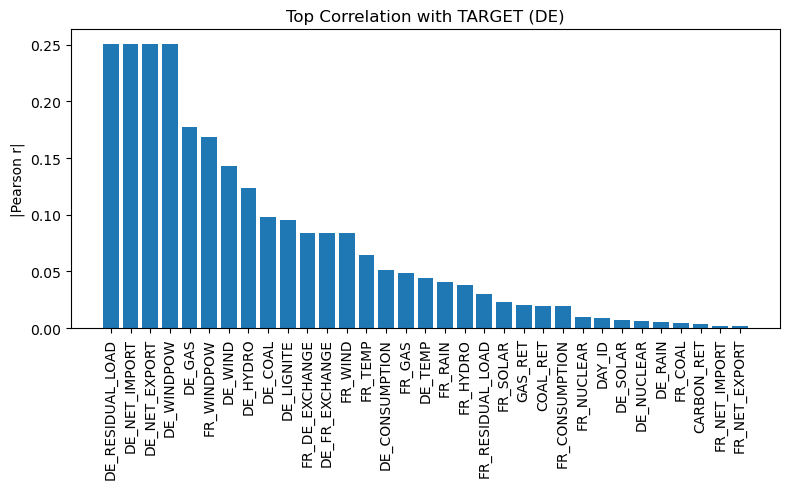

In [17]:
if "COUNTRY" not in df.columns:
    print("COUNTRY column not found; skipping per-country EDA.")
else:
    countries = [c for c in df["COUNTRY"].dropna().unique()]
    print("Countries found:", countries)

    for cc in countries:
        print("\n==============================")
        print(f"### COUNTRY: {cc}")
        d = df[df["COUNTRY"] == cc].copy()

        # Numeric features in this slice
        numc0 = [c for c in d.columns if c not in {"ID","DAY_ID","COUNTRY","TARGET"} and pd.api.types.is_numeric_dtype(d[c])]
        numc = [c for c in d.columns if c not in {"ID","COUNTRY","TARGET"} and pd.api.types.is_numeric_dtype(d[c])]
        print(f"Rows: {len(d)}; Numeric features: {len(numc)}")

        # Missingness (top 20)
        miss_c = d[numc].isna().sum().sort_values(ascending=False)
        miss_p = (miss_c / len(d)).sort_values(ascending=False)
        mdf = pd.DataFrame({"missing_count": miss_c, "missing_pct": miss_p})
        miss_count = (mdf['missing_count'] > 0).sum()
        display(mdf)

        plt.figure()
        plt.subplot(2, 1, 1)
        topm = mdf.head(miss_count)
        plt.bar(topm.index.astype(str), topm["missing_pct"].values)
        plt.xticks(rotation=90)
        plt.ylabel("Missing %")
        plt.title(f"Top Missing Features ({cc})")
        plt.tight_layout()
        plt.show()

        # Distributions (cap)
        for c in numc0:
            plt.figure()
            plt.subplot(3, 1, 1)
            d[c].plot(kind="hist", bins=40, alpha=0.7)
            plt.xlabel(c)
            plt.title(f"Distribution of {c} ({cc})")
            plt.tight_layout()
            plt.show()

        # Correlation heatmap (within country)
        if len(numc) >= 2:
            corr_c = d[numc].corr()
            plt.figure()
            plt.imshow(corr_c.values, aspect='auto', interpolation='nearest')
            plt.colorbar(label="Pearson r")
            plt.title(f"Feature-Feature Correlation Heatmap ({cc})")
            plt.tight_layout()
            plt.show()

        # Feature-Target correlation (within country)
        if "TARGET" in d.columns and len(numc) > 0:
            tc = d[numc + ["TARGET"]].corr()["TARGET"].drop("TARGET").sort_values(ascending=False)
            display(tc)
            tca = tc.abs().sort_values(ascending=False)
            plt.figure()
            plt.bar(tca.index.astype(str), tca.values)
            plt.xticks(rotation=90)
            plt.ylabel("|Pearson r|")
            plt.title(f"Top Correlation with TARGET ({cc})")
            plt.tight_layout()
            plt.show()

## 9. Time Series per Country (FR / DR)


### COUNTRY: FR
Selected features: ['FR_WINDPOW', 'DE_WINDPOW', 'FR_HYDRO', 'DE_NET_IMPORT', 'DE_NET_EXPORT', 'DE_RAIN', 'CARBON_RET', 'GAS_RET', 'DE_HYDRO', 'DE_CONSUMPTION', 'DE_RESIDUAL_LOAD', 'DE_WIND', 'DE_TEMP', 'FR_NET_EXPORT', 'FR_NET_IMPORT', 'FR_RAIN', 'FR_RESIDUAL_LOAD', 'DE_NUCLEAR', 'FR_DE_EXCHANGE', 'DE_FR_EXCHANGE', 'FR_TEMP', 'FR_WIND', 'DE_GAS', 'FR_COAL', 'DE_SOLAR', 'DE_COAL', 'FR_SOLAR', 'FR_CONSUMPTION', 'FR_GAS', 'FR_NUCLEAR', 'DE_LIGNITE', 'COAL_RET']


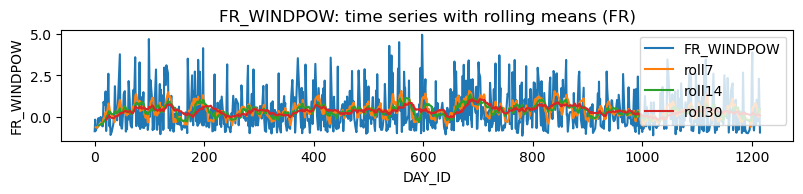

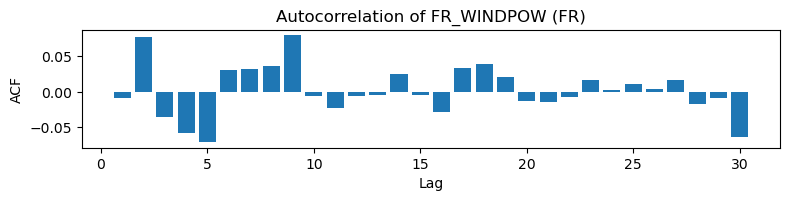

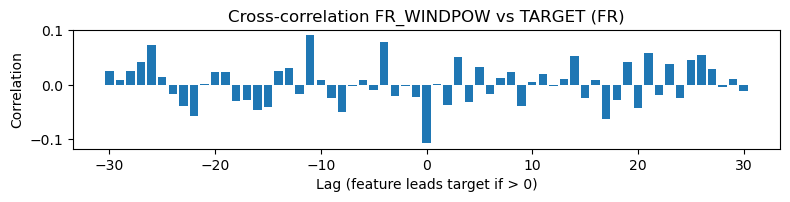

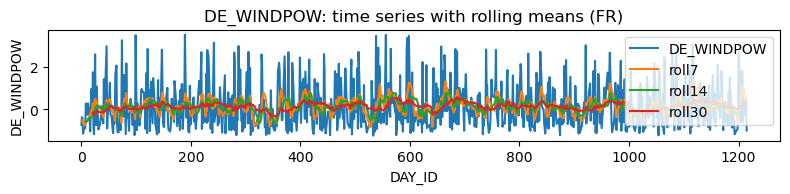

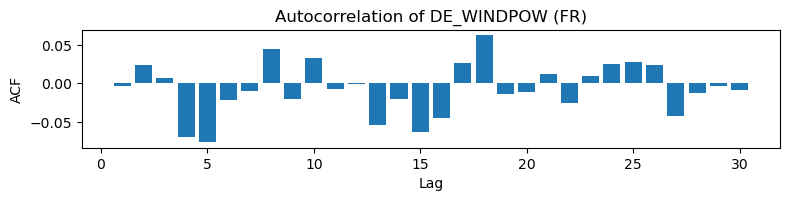

...

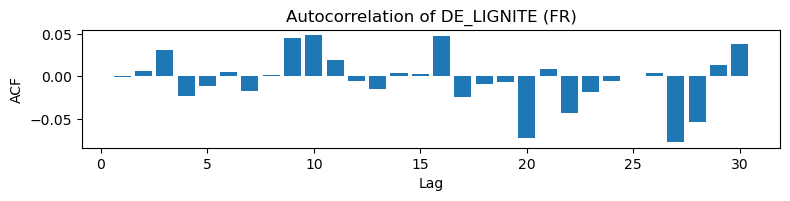

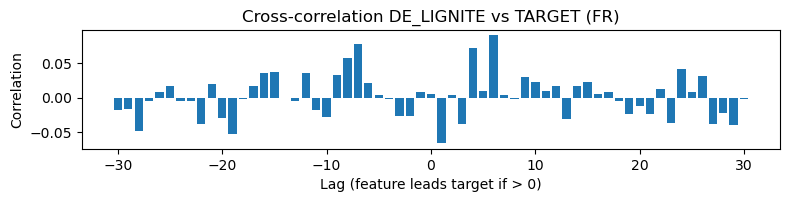

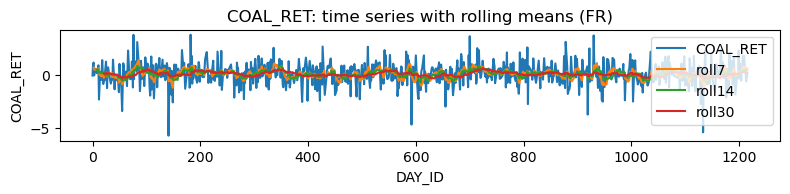

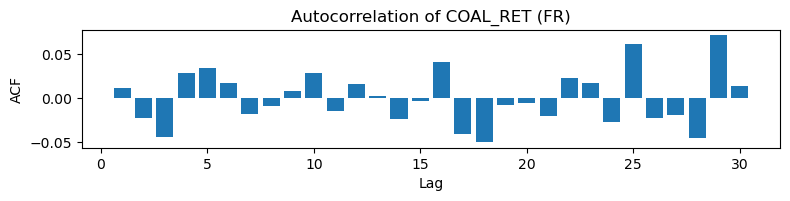

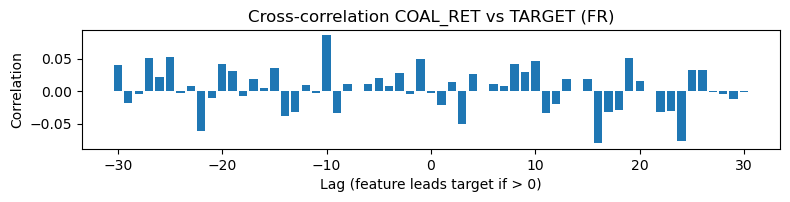


### COUNTRY: DE
Selected features: ['DE_RESIDUAL_LOAD', 'DE_NET_IMPORT', 'DE_NET_EXPORT', 'DE_WINDPOW', 'DE_GAS', 'FR_WINDPOW', 'DE_WIND', 'DE_HYDRO', 'DE_COAL', 'DE_LIGNITE', 'DE_FR_EXCHANGE', 'FR_DE_EXCHANGE', 'FR_WIND', 'FR_TEMP', 'DE_CONSUMPTION', 'FR_GAS', 'DE_TEMP', 'FR_RAIN', 'FR_HYDRO', 'FR_RESIDUAL_LOAD', 'FR_SOLAR', 'GAS_RET', 'COAL_RET', 'FR_CONSUMPTION', 'FR_NUCLEAR', 'DE_SOLAR', 'DE_NUCLEAR', 'DE_RAIN', 'FR_COAL', 'CARBON_RET', 'FR_NET_EXPORT', 'FR_NET_IMPORT']


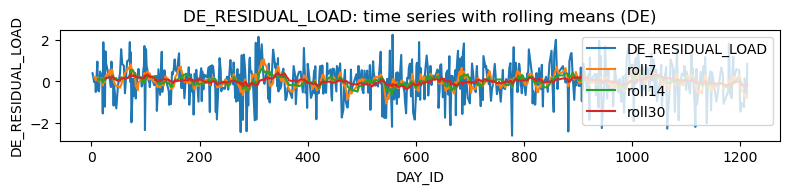

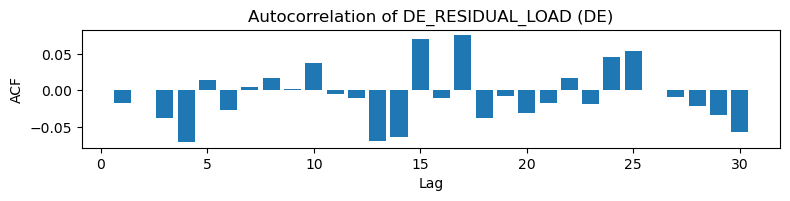

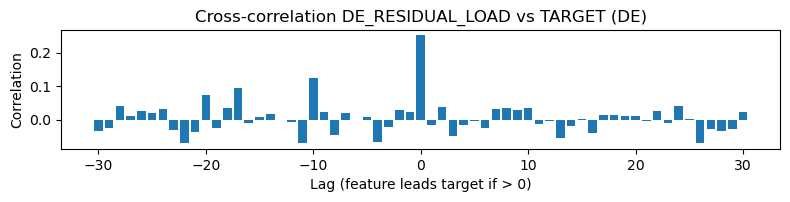

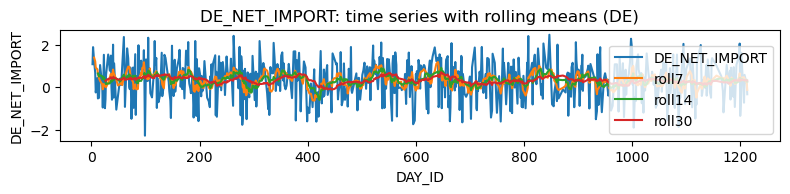

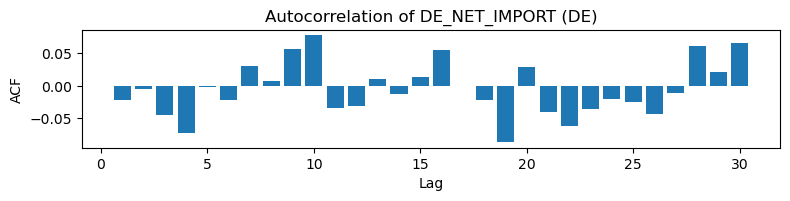

...

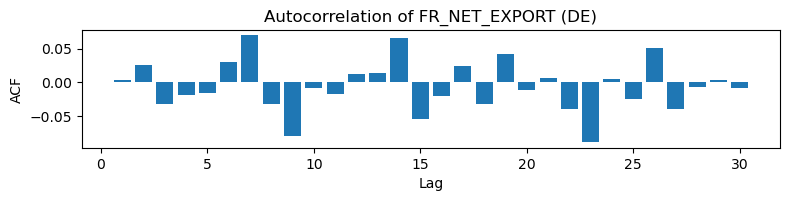

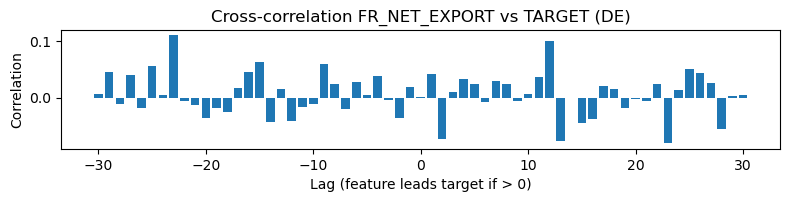

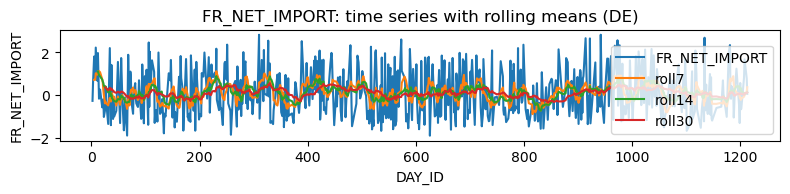

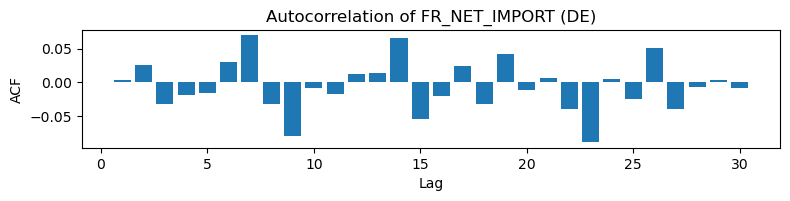

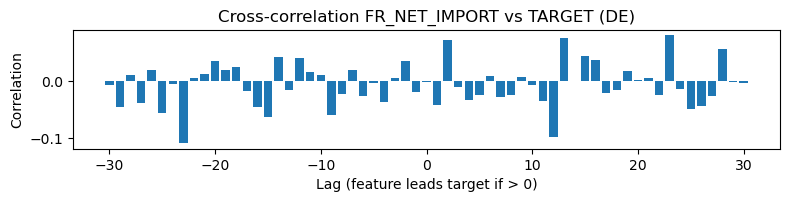

In [18]:
if "COUNTRY" not in df.columns:
    print("COUNTRY not found; skipping per-country TS analysis.")
else:
    for country in df["COUNTRY"].dropna().unique():
        print("\n==============================")
        print(f"### COUNTRY: {country}")
        d = df[df["COUNTRY"]==country].copy()
        if "DAY_ID" not in d.columns:
            print("DAY_ID not available; skip TS plots.")
            continue
        d = d.sort_values("DAY_ID")

        # Select features by |corr| within this country
        numc = [c for c in d.columns if c not in {"ID","DAY_ID","COUNTRY","TARGET"} and pd.api.types.is_numeric_dtype(d[c])]
        if "TARGET" not in d.columns or len(numc)==0:
            print("Skip (no target or no numeric cols).")
            continue
        corr_to_t = d[numc + ["TARGET"]].corr()["TARGET"].drop("TARGET").abs().sort_values(ascending=False)
        ts_feats_c = list(corr_to_t.index[:len(corr_to_t)])
        print("Selected features:", ts_feats_c)
        yv = d["TARGET"].astype(float).to_numpy()

        for c in ts_feats_c:
            # TS + rolling
            s = d[c].astype(float)
            plt.figure()
            plt.subplot(311)
            plt.plot(d["DAY_ID"], s, label=f"{c}")
            for w in ROLL_WINDOWS:
                try:
                    plt.plot(d["DAY_ID"], s.rolling(window=w, min_periods=max(1,w//2)).mean(), label=f"roll{w}")
                except Exception:
                    pass
            plt.xlabel("DAY_ID"); plt.ylabel(c)
            plt.title(f"{c}: time series with rolling means ({country})")
            plt.legend()
            plt.tight_layout()
            plt.show()

            # ACF
            vals = d[c].astype(float).to_numpy()
            acf = acf_values(vals)
            plt.subplot(312)
            plt.bar(np.arange(1, len(acf)+1), acf)
            plt.xlabel("Lag"); plt.ylabel("ACF")
            plt.title(f"Autocorrelation of {c} ({country})")
            plt.tight_layout()
            plt.show()

            # Cross-corr with TARGET
            xv = d[c].astype(float).to_numpy()
            lags, cc = lagged_corr(xv, yv)
            plt.subplot(313)
            plt.bar(lags, cc)
            plt.xlabel("Lag (feature leads target if > 0)")
            plt.ylabel("Correlation")
            plt.title(f"Cross-correlation {c} vs TARGET ({country})")
            plt.tight_layout()
            plt.show()

## 10. Missing Value Imputation Comparison

In [19]:
features = num_cols.copy()
y_vec = df["TARGET"].to_numpy()

def quick_eval(X_mat, y_vec):
    if "DAY_ID" in df.columns:
        order = np.argsort(df["DAY_ID"].to_numpy())
        split = int(0.8 * len(order))
        tr_idx, va_idx = order[:split], order[split:]
    else:
        tr_idx, va_idx = train_test_split(np.arange(len(df)), test_size=0.2, random_state=RANDOM_STATE)

    model = HistGradientBoostingRegressor(random_state=RANDOM_STATE, max_iter=600)
    model.fit(X_mat[tr_idx], y_vec[tr_idx])
    pred = model.predict(X_mat[va_idx])
    rmse = np.sqrt(np.mean((pred - y_vec[va_idx])**2))
    return rmse

imp_med = SimpleImputer(strategy="median")
X_med = imp_med.fit_transform(df[features])
rmse_med = quick_eval(X_med, y_vec)

imp_knn = KNNImputer(n_neighbors=5, weights="distance")
X_knn = imp_knn.fit_transform(df[features])
rmse_knn = quick_eval(X_knn, y_vec)

print({"rmse_median": rmse_med, "rmse_knn": rmse_knn})
use_knn = rmse_knn <= rmse_med
X_imputed = X_knn if use_knn else X_med
print("Chosen imputer:", "KNNImputer" if use_knn else "SimpleImputer(median)")

{'rmse_median': np.float64(1.034780231542586), 'rmse_knn': np.float64(1.0444992507742312)}
Chosen imputer: SimpleImputer(median)


## 11. Feature Selection

In [20]:
print("Before Feature Selection:", len(features))
vt = VarianceThreshold(threshold=1e-8)
X_vt = vt.fit_transform(X_imputed)
feats_vt = [f for f, keep in zip(features, vt.get_support()) if keep]
print("Kept after VarianceThreshold:", len(feats_vt))

def correlation_filter(X_df, cols, threshold=0.99):
    C = X_df[cols].corr().abs()
    keep = []
    dropped = set()
    for c in cols:
        if c in dropped:
            continue
        keep.append(c)
        high = C.index[(C[c] > threshold) & (C.index != c)].tolist()
        for h in high:
            dropped.add(h)
    return keep, sorted(list(dropped))

keep_cols, dropped_cols = correlation_filter(pd.DataFrame(X_imputed, columns=features), feats_vt, threshold=0.99)
print("Dropped due to high correlation:", dropped_cols)
print("Remaining after correlation filter:", len(keep_cols))

Before Feature Selection: 33
Kept after VarianceThreshold: 33
Dropped due to high correlation: ['DE_NET_IMPORT', 'FR_DE_EXCHANGE', 'FR_NET_IMPORT']
Remaining after correlation filter: 30


## 12. Mutual Information

DE_RESIDUAL_LOAD    0.060875
DE_WINDPOW          0.057345
FR_NET_EXPORT       0.047978
DE_WIND             0.046520
DE_LIGNITE          0.043323
DAY_ID              0.042981
DE_NET_EXPORT       0.037728
DE_RAIN             0.036929
DE_GAS              0.035325
FR_CONSUMPTION      0.030100
DE_TEMP             0.028471
FR_WIND             0.025232
FR_WINDPOW          0.020598
FR_SOLAR            0.019060
GAS_RET             0.018451
DE_NUCLEAR          0.018269
FR_COAL             0.016737
DE_CONSUMPTION      0.016692
FR_NUCLEAR          0.014526
CARBON_RET          0.013019
DE_COAL             0.010716
FR_RAIN             0.005695
FR_HYDRO            0.005402
FR_GAS              0.004800
DE_SOLAR            0.003395
DE_HYDRO            0.003095
DE_FR_EXCHANGE      0.000000
FR_RESIDUAL_LOAD    0.000000
FR_TEMP             0.000000
COAL_RET            0.000000
dtype: float64

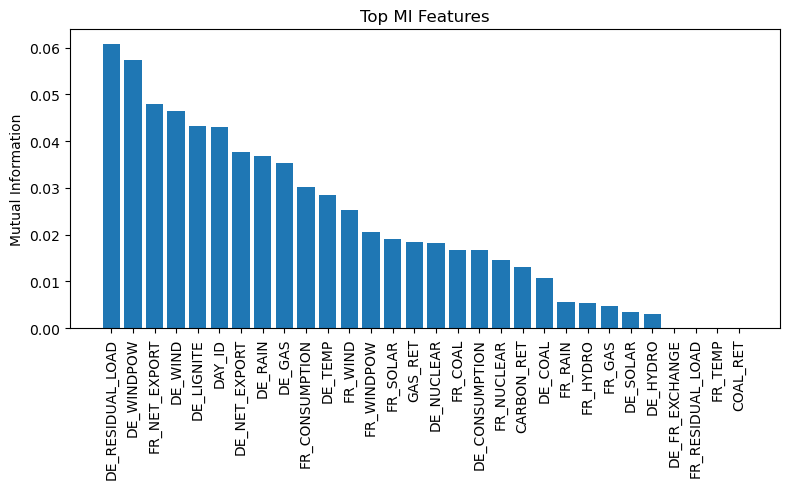

In [21]:
# Mutual Information ranking (top-k)
mi = mutual_info_regression(pd.DataFrame(X_imputed, columns=features)[keep_cols], y_vec, random_state=RANDOM_STATE)
mi_series = pd.Series(mi, index=keep_cols).sort_values(ascending=False)
display(mi_series)

plt.figure()
plt.bar(mi_series.index.astype(str), mi_series.values)
plt.xticks(rotation=90)
plt.ylabel("Mutual Information")
plt.title("Top MI Features")
plt.tight_layout()
plt.show()

## 13. Feature Extraction (PCA)

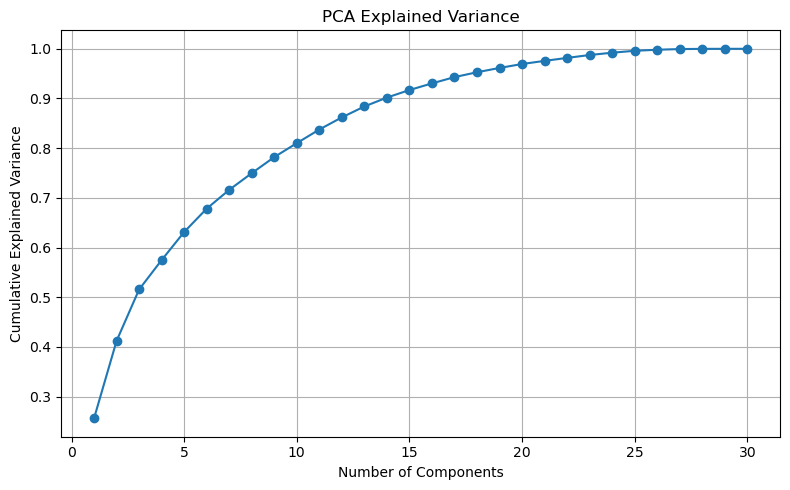

Components to reach 95% variance: 18


In [22]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(pd.DataFrame(X_imputed, columns=features)[keep_cols])

pca = PCA(n_components=X_scaled.shape[1], random_state=RANDOM_STATE)
X_pca = pca.fit_transform(X_scaled)

cum_var = np.cumsum(pca.explained_variance_ratio_)
plt.figure()
plt.plot(np.arange(1, len(cum_var)+1), cum_var, marker='o')
plt.xlabel("Number of Components")
plt.ylabel("Cumulative Explained Variance")
plt.title("PCA Explained Variance")
plt.grid(True)
plt.tight_layout()
plt.show()

print("Components to reach 95% variance:", int((cum_var >= 0.95).argmax()+1) if (cum_var >= 0.95).any() else len(cum_var))

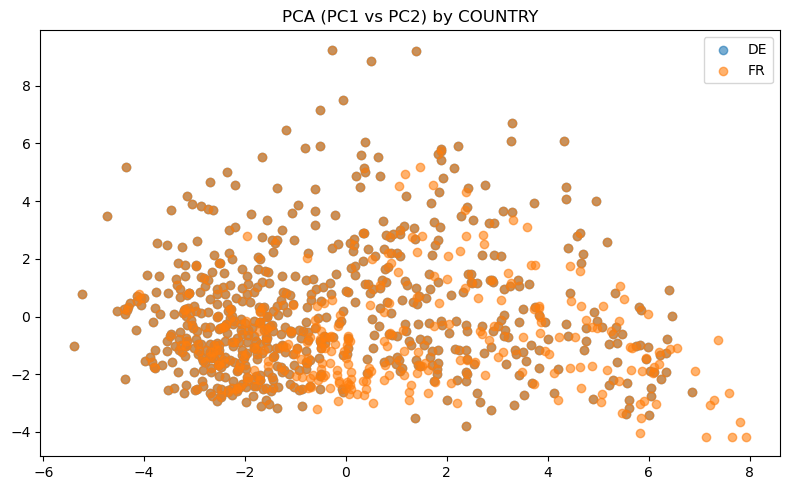

In [23]:
if "COUNTRY" in df.columns and df["COUNTRY"].nunique()<=10:
    plt.figure()
    tmp=df.copy(); tmp["PC1"]=X_pca[:,0]; tmp["PC2"]=X_pca[:,1]
    for k,g in tmp.groupby("COUNTRY"):
        plt.scatter(g["PC1"],g["PC2"],alpha=0.6,label=str(k))
    plt.legend(); plt.title("PCA (PC1 vs PC2) by COUNTRY"); plt.tight_layout(); plt.show()